# NLP Visualization

In this section, visualisations are created to represent the result of both the extraction of geographical values and keywords. Different graphics are created, including a wordcloud and maps. Finally, a hierarchical dataset is created in order to construct a Voronoi Treemap, implemented with Javascript

In [2]:
#Required libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
from wordcloud import WordCloud
from PIL import Image
import plotly.express as px
import ast
import geopandas as gpd
import pycountry_convert as pc
import json
import os
import plotly.graph_objects as go
import plotly.subplots as sp

In [45]:
df = pd.read_csv('final_geo_kw2.csv', index_col=0)

In [4]:
df

,Unnamed: 0.1,Unnamed: 0,corpusid,externalids,url,title,authors,venue,publicationvenueid,year,...,add_type,country_only,continent,Ocean_Sea_Bay,waters_coord,coord_countr,coord_cont,keywords,keywords_new,ISO_CODE3
0,0,0,210843200,"{'ACL': None, 'DBLP': 'journals/remotesensing/...",https://www.semanticscholar.org/paper/381b8081...,Analyzing Space-Time Coherence in Precipitatio...,"[{'authorId': '3141133', 'name': 'M. Lanfredi'...",Remote Sensing,8e1bd4b5-d5b2-4e22-ba0a-01fe5568d472,2020.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['geography', 'northernmost', 'precipitation',...","['geography', 'northernmost', 'precipitation',...",NaN
1,1,1,154931899,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/d4d1370e...,"Trends in sub-hourly, sub-daily and daily extr...","[{'authorId': '104995180', 'name': 'Orpita U. ...",NaN,NaN,2014.0,...,['country'],['Australia'],['Oceania'],NaN,NaN,"[(-24.7761086, 134.755)]","[(-12.7725835, 173.7741688)]","['catchment', 'elevation', 'rainfall', 'stormw...","['catchment', 'elevation', 'rainfall', 'stormw...",['AUS']
2,2,2,256336442,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/e4c7c633...,Development of a data-verified ionospheric mod...,"[{'authorId': '2116929839', 'name': 'Jeongheon...",Journal of the Korean Physical Society,79534c98-709c-43db-be0d-8e03561d8d63,2016.0,...,['country'],"['Korea, Republic of']",['Asia'],NaN,NaN,"[(38.233686649999996, 127.00873073371443)]","[(51.2086975, 89.2343748)]","['ionization', 'ionosphere', 'ionospheric', 'i...","['ionization', 'ionosphere', 'ionospheric', 'i...",['KOR']
3,3,3,131121356,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/a8932c17...,"Modelling Runoff on a Small Lowland Catchment,...","[{'authorId': '108342409', 'name': 'Tamás Práv...",NaN,NaN,2015.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['carpathian', 'catchment', 'drought', 'hydrol...","['carpathian', 'catchment', 'drought', 'hydrol...",NaN
4,4,4,127251655,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/8c51c26d...,Floating with seeds: understanding hydrochorou...,"[{'authorId': '7203483', 'name': 'T. V. D. Sto...",NaN,NaN,2012.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['coastal', 'conservation', 'ecosystem', 'mang...","['coastal', 'conservation', 'ecosystem', 'mang...",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72350,72350,72350,59961611,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/e0d226bb...,Human Paleoecology in the Levantine Corridor,"[{'authorId': '103631716', 'name': 'P. Willoug...",NaN,NaN,2006.0,...,"['continent', 'country', 'country', 'country',...","['Australia', 'Belarus', 'Israel', 'Kenya', 'U...","['Africa', 'Asia', 'Europe', 'North America', ...",NaN,NaN,"[(-24.7761086, 134.755), (53.4250605, 27.69713...","[(11.5024338, 17.7578122), (51.2086975, 89.234...","['palaeoanthropological', 'palaeoecology', 'pa...","['palaeoanthropological', 'palaeoecology', 'pa...","['AUS', 'BLR', 'ISR', 'KEN', 'USA']"
72351,72351,72351,23260559,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/ae01bea1...,Epidemiology of Childhood Type 1 Diabetes Mell...,"[{'authorId': '2122945', 'name': 'O. Cinek', '...",Hormone Research in Paediatrics,6b515834-8065-438e-8a99-175de02e242a,2011.0,...,"['country', 'continent']",['Belarus'],['Europe'],NaN,NaN,"[(53.4250605, 27.6971358)]","[(51.0, 10.0)]","['diabetes', 'epidemiology', 'europe', 'europe...","['diabetes', 'epidemiology', 'europe', 'europe...",['BLR']
72352,72352,72352,212478679,"{'ACL': None, 'DBLP': None, 'ArXiv': None, 'MA...",https://www.semanticscholar.org/paper/d8cc4a0d...,Study Of PV Modules In Grid Connected Distribu...,"[{'authorId': '2060393979', 'name': 'Dalia Deb...",NaN,NaN,2019.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['dg', 'distributed', 'grid', 'inverter', 'irr...","['dg', 'di

## World-shaped wordcloud

In [5]:
#Creating a string made of all the keywords present in the dataset, to create a word cloud.
wl = ''
for i in tqdm(df['keywords_new']):
    for j in eval(i):
        wl = wl + j + ' ' 

100%|██████████| 72355/72355 [23:30<00:00, 51.28it/s] 


In [6]:
#Load a world mask to shape the wordcloud
mask = np.array(Image.open("Mask/black_world.jpg"))

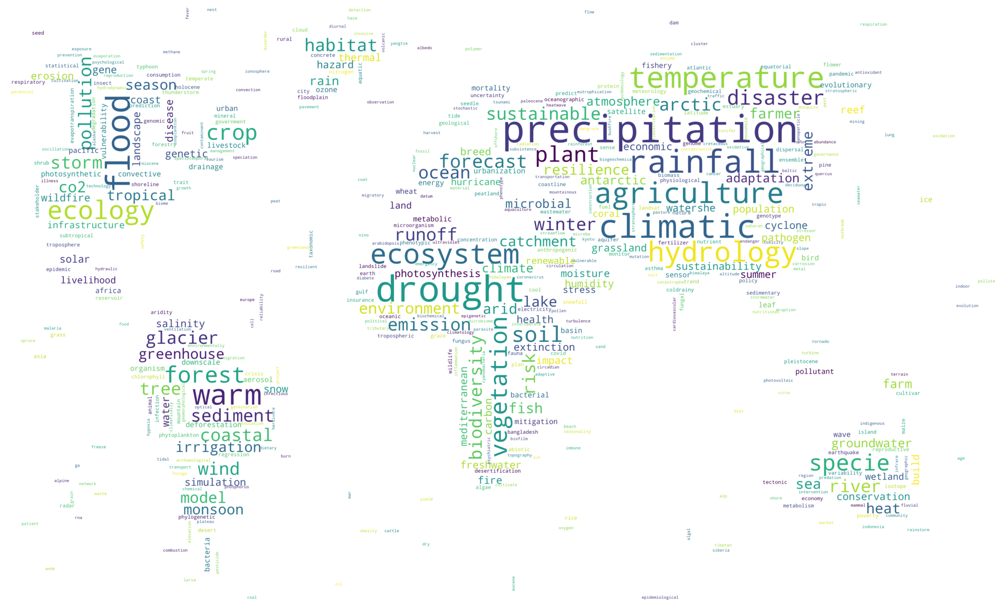

In [7]:
#Plotting the wordcloud
wc = WordCloud(collocations=False, mask=mask, background_color='white', max_words=490,scale=10, min_font_size=0.1, colormap='viridis').generate(wl)
plt.figure(figsize=(30, 15))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

## Geographical exploration

Two graphs are constructed to investigate the distribution of keywords in the different continents:
1. Barplot with the top 10 keywords by number of occurrences for each continent
2. Radarplot displaying the position for each continent of the words in common between all the continents, with the exception of Antarctica which is a peculiar case

In [46]:
#Explorating continents present in the dataset
continent = []
for i in df['continent']:
    if pd.isna(i) == False:
        for j in eval(i):
            continent.append(j)

np.unique(continent)

array(['Africa', 'Antarctica', 'Asia', 'Europe', 'North America',
       'North Pole', 'Oceania', 'South America'], dtype='<U13')

In [9]:
#Creating a list for each continent
for cont in np.unique(continent):
    globals()["_".join(cont.split())] = []

In [10]:
#Saving the keywords for each continent
for cont in np.unique(continent):
    globals()["_".join(cont.split())] = []
count=0
for i in range(len(df)):
    check = False
    if pd.isna(df['continent'][i])==False:
        for j in eval(df['continent'][i]):
            if j == 'Africa':
                Africa.extend(eval(df['keywords_new'][i]))
            if j == 'Antarctica':
                Antarctica.extend(eval(df['keywords_new'][i]))
            if j == 'Asia':
                Asia.extend(eval(df['keywords_new'][i]))
            if j == 'Europe':
                Europe.extend(eval(df['keywords_new'][i]))
            if j == 'North America':
                North_America.extend(eval(df['keywords_new'][i]))
            if j == 'North Pole':
                if check == False:
                    count += 1
                check = True
                North_Pole.extend(eval(df['keywords_new'][i]))
            if j == 'Oceania':
                Oceania.extend(eval(df['keywords_new'][i]))
            if j == 'South America':
                South_America.extend(eval(df['keywords_new'][i]))

In [11]:
#Creating a dataframe with the occurrences for each keyword in each continent
for cont in np.unique(continent):
    keys, counts = np.unique(globals()["_".join(cont.split())], return_counts=True)
    globals()["df" + "_" + "_".join(cont.split())] = pd.DataFrame({'keys':keys,'counts':counts})
    globals()["df" + "_" + "_".join(cont.split())] = globals()["df" + "_" + "_".join(cont.split())].sort_values(by='counts',ascending=False)

c:\Users\cosim\anaconda3\envs\tesi\Lib\site-packages\matplotlib_inline\backend_inline.py:27: UserWarning: The Figure parameters 'layout' and 'constrained_layout' cannot be used together. Please use 'layout' only.
  return new_figure_manager_given_figure(num, FigureClass(*args, **kwargs))


Text(0.5, 0, 'occurrences')

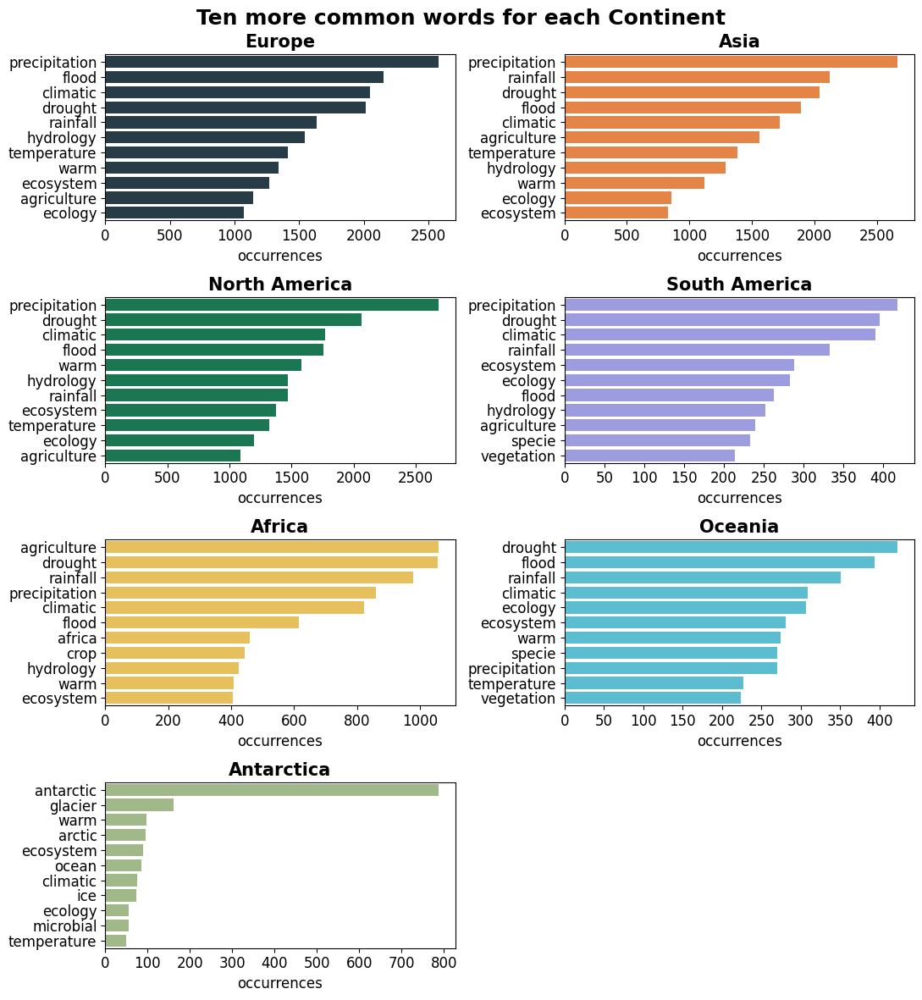

In [12]:
#Plotting a barplot with the ten more frequent keywords per continent
main = plt.figure(constrained_layout=False, figsize=(11,12),layout='tight')
main.suptitle('Ten more common words for each Continent', fontsize=18, fontweight='bold')
gs = main.add_gridspec(4,2)

ax1 = main.add_subplot(gs[0,0])
ax1 = sns.barplot(df_Europe[0:11], x='counts', y ='keys', color = '#233d4d')
plt.title('Europe', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax2 = main.add_subplot(gs[0,1])
ax2 = sns.barplot(df_Asia[0:11], x='counts', y ='keys', color = '#fe7f2d')
plt.title('Asia', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax3 = main.add_subplot(gs[1,0])
ax3 = sns.barplot(df_North_America[0:11], x='counts', y ='keys', color= '#0A8754')
plt.title('North America', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax4 = main.add_subplot(gs[1,1])
ax4 = sns.barplot(df_South_America[0:11], x='counts', y ='keys', color = '#9191E9')
plt.title('South America', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax5 = main.add_subplot(gs[2,0])
ax5 = sns.barplot(df_Africa[0:11], x='counts', y ='keys', color='#fcca46')
plt.title('Africa', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax6 = main.add_subplot(gs[2,1])
ax6 = sns.barplot(df_Oceania[0:11], x='counts', y ='keys', color = '#48cae4')
plt.title('Oceania', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize=12)

ax7 = main.add_subplot(gs[3,0])
ax7 = sns.barplot(df_Antarctica[0:11], x='counts', y ='keys', color = '#a1c181')
plt.title('Antarctica', fontsize=15, fontweight='bold')
plt.ylabel(None)
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xlabel('occurrences', fontsize =12)



In [13]:
#Finding the common words in the first 15 of each continent
common_elements = list(set(df_Africa.iloc[0:16, 0].values) &
                      set(df_Europe.iloc[0:16, 0].values) &
                      set(df_South_America.iloc[0:16, 0].values) &
                      set(df_North_America.iloc[0:16, 0].values) &
                      set(df_Oceania.iloc[0:16, 0].values) &
                      set(df_Asia.iloc[0:16, 0].values))

In [14]:
#Plotting the radars
continents = ['Europe','Asia','North America', 'South America','Africa','Oceania']
titles = ['<b>Europe</b>', '<b>Asia</b>', '<b>North America</b>', '<b>South America</b>', '<b>Africa</b>', '<b>Oceania</b>']


categories = [
    'warm',
    'temperature',
    'climatic',
    'precipitation',
    'rainfall',
    'flood',
    'hydrology',
    'agriculture',
    'vegetation',
    'ecosystem',
    'ecology',
    'drought']
categories.append(categories[0])

fig = sp.make_subplots(rows=3, cols=2,specs=[[{"type": "polar"} for _ in range(2)] for _ in range(3)], subplot_titles=titles, vertical_spacing=0.1)

count=2
riga = 0
colo = 2
for cont in continents:
    if colo==2:
      colo=1
    else:
      colo=2
    if count % 2 == 0:
      riga += 1
    globals()["df" + "_" + "_".join(cont.split())]["rank"] = globals()["df" + "_" + "_".join(cont.split())]['counts'].rank(ascending=False).astype(int)
    radius = []
    for i in categories:
        try:
            radius.append(globals()["df" + "_" + "_".join(cont.split())][globals()["df" + "_" + "_".join(cont.split())]['keys'] == i ]["rank"].values.tolist()[0])
        except:
            radius.append(0)
    radius.append(radius[0])
    fig.add_trace(go.Scatterpolar(
      r=radius,
      theta=categories,
      fill='toself',
      name=cont),
      row=riga,
      col=colo
      )
    
    fig.update_polars(row=riga, col=colo, radialaxis=dict(visible=True, range=[15, 1],type='linear',dtick=1,tick0=1,ticklabelstep=2,tickfont = dict(size = 14)), angularaxis = dict(tickfont = dict(size = 17)))
                  
    count += 1

fig.update_layout(
        showlegend=False,
        height=1400,
        width=1200,
        title_text='<b>Keywords Ranking per Continent<b>',
        title_x = 0.5,
        title_y= 0.985,
        title_font=dict(size=22, color='black')
        )

for annotation in fig['layout']['annotations']: 
        annotation['height']=80
        annotation['font']=dict(size=20)
fig.show()

## Geographical Maps

Maps are built to geographically distribute the results of the analysis. With the aim of defining the most represented countries

In [15]:
#Keeping only the entries with geographical information
df_map = df.dropna(subset='country_only')

In [16]:
#Getting a list og the ISO CODEs
countries = []
for i in df_map['ISO_CODE3']:
    for j in eval(i):
        countries.append(j)

In [17]:
#Counting the number of time an ISO CODE appear
keys, counts = np.unique(countries, return_counts=True)
map_plot = pd.DataFrame({'ISO3':keys,'papers':counts})

In [18]:
#Mapping each country to his ISO
iso_mapping = {}
for country_list,iso_list in zip(df_map['country_only'], df_map['ISO_CODE3']):
    for country, iso in zip(eval(country_list), eval(iso_list)):
        if iso not in iso_mapping:
            iso_mapping[iso] = country

In [19]:
#Joining the countries to the dataset with the counts of ISO
map_plot['country'] = map_plot['ISO3'].map(iso_mapping)

In [20]:
#Most present countries in the papers
fig = px.choropleth(map_plot, locations="ISO3",
                    color="papers", # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.update_layout(
        height=800,
        width=1400
        )
fig.show()

In [21]:
#Getting the exact coordinates of each location mention in the papers
locations = []
latitudes = []
longitudes = []
for location_list, latitude_list, longitude_list in zip(df_map['location'], df_map['latitude'], df_map['longitude']):
    for location, lat, long in zip(eval(location_list), eval(latitude_list), eval(longitude_list)):
        locations.append(location)
        latitudes.append(lat)
        longitudes.append(long)
df_dot = pd.DataFrame({'location':locations, 'latitude':latitudes, 'longitude':longitudes})

In [22]:
#Plotting the results
fig = px.scatter_mapbox(df_dot,
                        lat='latitude',
                        lon='longitude',
                        hover_name="location",
                        zoom=1).update_traces(marker={"size": 4, 'color':'darkblue'})
fig.update_layout(mapbox_style="open-street-map",
                  margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  height=800,
                  width=1200)
fig.update_geos(
    showcountries=True,
    showocean=True, oceancolor="#bde0fe",
    landcolor="white")
fig.show()

In [23]:
df_dot

,location,latitude,longitude
0,Australia,-24.776109,134.755000
1,South Korea,36.638392,127.696119
2,China,30.564146,114.291705
3,None,NaN,NaN
4,None,NaN,NaN
...,...,...,...
184314,None,NaN,NaN
184315,Europe,51.000000,10.000000
184316,Belarus,53.860820,27.550832
184317,Italy,41.828116,12.515149


In [24]:
#Mapping the density of the papers for each location
fig = px.density_mapbox(df_dot, lat='latitude', lon='longitude', radius=1,
                        center=dict(lat=0, lon=180), zoom=1,
                        mapbox_style="open-street-map")
fig.update_layout(
                  margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  height=800,
                  width=1200)
fig.show()

In [30]:
#Mapping each country into a continent thanks to pycountry library
iso_conv = pc.map_country_alpha3_to_country_alpha2()
iso_conv['XKX'] = 'KS'
map_plot['ISO2'] = map_plot['ISO3'].map(iso_conv)
continent_mapping = {}
missing = {}
for iso, country in zip(map_plot['ISO2'], map_plot['country']):
    if iso not in continent_mapping:
        try:
            continent_mapping[iso] = pc.convert_continent_code_to_continent_name(pc.country_alpha2_to_continent_code(iso))
        except:
            missing[country] = iso
missing

{'Antarctica': 'AQ',
 'Western Sahara': 'EH',
 'Timor-Leste': 'TL',
 'Kosovo': 'KS'}

In [31]:
continent_mapping['AQ'] = 'Antarctica'
continent_mapping['EH'] = 'Africa'
continent_mapping['TL'] = 'Oceania'
continent_mapping['KS'] = 'Europe'

In [32]:
map_plot['continent'] = map_plot['ISO2'].map(continent_mapping)

In [33]:
map_plot[map_plot['continent']=='Antarctica']

,ISO3,papers,country,ISO2,continent
8,ATA,17,Antarctica,AQ,Antarctica


In [34]:
#Bubble chart with size representing number of times a country is cited into an article, and the color the continent to which the country belongs
df = px.data.gapminder().query("year==2020")
fig = px.scatter_geo(map_plot, locations="ISO3", color="continent",
                     hover_name="country", size=(map_plot["papers"])**0.8,
                     size_max=70)
fig.update_layout(mapbox_style="open-street-map",
                  margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  height=700,
                  width=1400,
                  showlegend=False)
fig.update_geos(
    showcountries=True,
    showocean=True, oceancolor="#AAD3DF",
    landcolor="white")
fig.show()

In [35]:
df = px.data.gapminder().query("year==2020")
fig = px.choropleth(map_plot, locations="ISO3",
                    color=np.log(map_plot["papers"]), 
                    hover_name="country", 
                    color_continuous_scale=px.colors.sequential.Plasma)

fig.update_layout(mapbox_style="open-street-map",
                  margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  height=700,
                  width=1400,
                  showlegend=False)
fig.update_geos(
    showcountries=True,
    showocean=True, oceancolor="#bde0fe",
    landcolor="white")
fig.show()

### Voronoi Treemap

Creating a hierarchical dictionary to build the voronoi Tremap, built with javascript

In [36]:
map_plot

,ISO3,papers,country,ISO2,continent
0,AFG,150,Afghanistan,AF,Asia
1,AGO,89,Angola,AO,Africa
2,AIA,5,Anguilla,AI,North America
3,ALB,226,Albania,AL,Europe
4,AND,4,Andorra,AD,Europe
...,...,...,...,...,...
207,XKX,38,Kosovo,KS,Europe
208,YEM,306,Yemen,YE,Asia
209,ZAF,1082,South Africa,ZA,Africa
210,ZMB,173,Zambia,ZM,Africa


In [37]:
#Build a list with continent and countries. Countires have information on the parent (continent) and value (number of papers that cite the country)
data_js = []
for continent in range(len(np.unique(map_plot['continent'].values))):
    dict_continent = {}
    dict_continent['id'] = continent + 1
    dict_continent['name'] = list(np.unique(map_plot['continent'].values))[continent]
    data_js.append(dict_continent)
for i in range(len(map_plot)):
    dict_cont = {}
    dict_cont['id'] = i + 1
    dict_cont['name'] = map_plot['country'][i]
    dict_cont['value'] = map_plot['papers'][i]
    for element in data_js:
        if element['name'] == map_plot['continent'][i]:
            dict_cont['parent'] = element['id']
    data_js.append(dict_cont)

In [38]:
data_js

[{'id': 1, 'name': 'Africa'},
 {'id': 2, 'name': 'Antarctica'},
 {'id': 3, 'name': 'Asia'},
 {'id': 4, 'name': 'Europe'},
 {'id': 5, 'name': 'North America'},
 {'id': 6, 'name': 'Oceania'},
 {'id': 7, 'name': 'South America'},
 {'id': 1, 'name': 'Afghanistan', 'value': 150, 'parent': 3},
 {'id': 2, 'name': 'Angola', 'value': 89, 'parent': 1},
 {'id': 3, 'name': 'Anguilla', 'value': 5, 'parent': 5},
 {'id': 4, 'name': 'Albania', 'value': 226, 'parent': 4},
 {'id': 5, 'name': 'Andorra', 'value': 4, 'parent': 4},
 {'id': 6, 'name': 'United Arab Emirates', 'value': 79, 'parent': 3},
 {'id': 7, 'name': 'Argentina', 'value': 643, 'parent': 7},
 {'id': 8, 'name': 'Armenia', 'value': 29, 'parent': 3},
 {'id': 9, 'name': 'Antarctica', 'value': 17, 'parent': 2},
 {'id': 10, 'name': 'Antigua and Barbuda', 'value': 12, 'parent': 5},
 {'id': 11, 'name': 'Australia', 'value': 3284, 'parent': 6},
 {'id': 12, 'name': 'Austria', 'value': 646, 'parent': 4},
 {'id': 13, 'name': 'Azerbaijan', 'value': 36,

In [39]:
#convert the values to integer
for item in data_js:
    for key, value in item.items():
        if isinstance(value, np.int64):
            item[key] = int(value)

In [40]:
#Saving the result
file_path = "C:/Users/cosim/Desktop/Tesi_off/Packing_circles/circle_data.json"

# Write data to the JSON file
with open(file_path, 'w') as json_file:
    json.dump(data_js, json_file, indent=4)

In [42]:
#Building a different dataset for different library in javascript in which continent have information on children (the countries), that have information on the values
data_js_vor = {'name': "world",
               'children': []}
total_papers = map_plot['papers'].sum()
for continent in range(len(np.unique(map_plot['continent'].values))):
    dict_continent = {}
    dict_continent['name'] = list(np.unique(map_plot['continent'].values))[continent]
    print('Total papers for', list(np.unique(map_plot['continent'].values))[continent],'are:', map_plot[map_plot['continent']==list(np.unique(map_plot['continent'].values))[continent]]['papers'].sum())
    if dict_continent['name'] == 'Europe':
        dict_continent['color'] = '#B684EE'
    if dict_continent['name'] == 'North America':
        dict_continent['color'] = '#4CDBB5'
    if dict_continent['name'] == 'South America':
        dict_continent['color'] = '#FFBD8B'
    if dict_continent['name'] == 'Africa':
        dict_continent['color'] = '#F48875'
    if dict_continent['name'] == 'Asia':
        dict_continent['color'] = '#9299FC'
    if dict_continent['name'] == 'Oceania':
        dict_continent['color'] = '#FF94B3'
    if dict_continent['name'] == 'Antarctica':
        dict_continent['color'] = '#5EE0F7'
    children = []
    for i in range(len(map_plot[map_plot['continent']==list(np.unique(map_plot['continent'].values))[continent]])):
        dict_cont = {}
        dict_cont['name'] = map_plot[map_plot['continent']==list(np.unique(map_plot['continent'].values))[continent]]['country'].iloc[i]
        dict_cont['weight'] = round((map_plot[map_plot['continent']==list(np.unique(map_plot['continent'].values))[continent]]['papers'].iloc[i]/total_papers)*100,2)
        children.append(dict_cont)
    dict_continent['children'] = children
    data_js_vor['children'].append(dict_continent)

Total papers for Africa are: 8986
Total papers for Antarctica are: 17
Total papers for Asia are: 23965
Total papers for Europe are: 33399
Total papers for North America are: 27710
Total papers for Oceania are: 4464
Total papers for South America are: 5069


In [43]:
#Saving the result
file_path = "C:/Users/cosim/Desktop/Tesi_off/Packing_circles/vor_data.json"

# Write data to the JSON file
with open(file_path, 'w') as json_file:
    json.dump(data_js_vor, json_file, indent=4, default=str)